In [54]:
using Pkg
Pkg.add("CSV")
Pkg.add("DataFrames")
using CSV, DataFrames

   Resolving package versions...


  No Changes to `~/.julia/environments/v1.8/Project.toml`
  No Changes to `~/.julia/environments/v1.8/Manifest.toml`


   Resolving package versions...
  No Changes to `~/.julia/environments/v1.8/Project.toml`
  No Changes to `~/.julia/environments/v1.8/Manifest.toml`


In [55]:
df = CSV.read("/Users/desgi/Desktop/Julia/business_unsupervised_learning/Map_of_Registered_Business_Locations.csv", DataFrame)

,Location Id,Business Account Number,Ownership Name,DBA Name
,String15,Int64,String,String
1,0474285-05-001,474285,Pressed Juicery Inc,Pressed Juicery
2,0474285-06-001,474285,Pressed Juicery Inc,Pressed Juicery
3,1045798-12-151,1021444,Benhammou Ahmida,Zaalouk Market & Deli Grocery
4,1170655-12-171,1080758,San Francisco Security Services Llc,San Francisco Security Services Llc
5,1172862-12-171,1081156,Teresa. Spalding,Teresa Spalding
6,1172877-12-171,1081158,Three R Properties,Three R Properties
7,1172879-12-171,1081159,"Rhi-Mosser 275 Turk, Lp","Rhi-Mosser 275 Turk, Lp"
8,1173595-12-171,1081185,Weibin Wu,Weibin Wu
9,1173614-12-171,1081187,Ockchain Inc,Ockchain Inc


Descriptive Statistics

In [56]:
describe(df, :mean, :std, :min, :max, :median, :q25, :q75, :eltype, :nunique, :nmissing)

,variable,mean,std,min
,Symbol,Union…,Union…,Any
1,Location Id,,,0000024-02-999
2,Business Account Number,6.23106e5,3.30976e5,24
3,Ownership Name,,,#10 Sports Llc
4,DBA Name,,,#1 Babes
5,Street Address,,,#10
6,City,,,0
7,State,,,AB
8,Source Zipcode,92957.8,9370.88,0
9,Business Start Date,,,01/01/1941


In [57]:
size(df,1)

222871

Renaming variables

In [58]:
rename!(df,[n => replace(string(n), " "=> "_") |> Symbol for n in names(df)])

,Location_Id,Business_Account_Number,Ownership_Name,DBA_Name
,String15,Int64,String,String
1,0474285-05-001,474285,Pressed Juicery Inc,Pressed Juicery
2,0474285-06-001,474285,Pressed Juicery Inc,Pressed Juicery
3,1045798-12-151,1021444,Benhammou Ahmida,Zaalouk Market & Deli Grocery
4,1170655-12-171,1080758,San Francisco Security Services Llc,San Francisco Security Services Llc
5,1172862-12-171,1081156,Teresa. Spalding,Teresa Spalding
6,1172877-12-171,1081158,Three R Properties,Three R Properties
7,1172879-12-171,1081159,"Rhi-Mosser 275 Turk, Lp","Rhi-Mosser 275 Turk, Lp"
8,1173595-12-171,1081185,Weibin Wu,Weibin Wu
9,1173614-12-171,1081187,Ockchain Inc,Ockchain Inc


In [59]:
Pkg.add("Query")
using Query

@from i in df begin
    @where i.Parking_Tax == true
    @select i
    @collect DataFrame
end

   Resolving package versions...


  No Changes to `~/.julia/environments/v1.8/Project.toml`
  No Changes to `~/.julia/environments/v1.8/Manifest.toml`


,Location_Id,Business_Account_Number,Ownership_Name,DBA_Name
,String15,Int64,String,String
1,1173734-12-171,1081206,Test 12/28/2017,Test 12/28/2017 Location 1 / Parking
2,0331622-05-001,331622,Douglas Parking Llc,Douglas Parking
3,0331622-07-001,331622,Douglas Parking Llc,Douglas Parking
4,1003077-07-141,331622,Douglas Parking Llc,Douglas Parking
5,1059531-03-161,1009459,Volume Parking Services Inc,Volume Parking Services
6,1099910-08-161,331622,Douglas Parking Llc,Douglas Parking
7,1138241-02-171,331622,Douglas Parking Llc,Douglas Parking
8,1173943-12-171,433156,Hyde Park Management Llc,Hyde Park Management Llc
9,1003009-07-141,329140,Imperial Parking (Us) Llc,Chestnut Street Lot


In [60]:
Pkg.add("DataValues")
using DataValues

clean_df = @from b in df begin
           @where lowercase(b.City) == "san francisco" && b.State =="CA" &&
           ! isna(b.Street_Address) && ! isna(b.Source_Zipcode) &&
           ! isna(b.NAICS_Code) && ! isna(b.NAICS_Code_Description) &&
           ! isna(b.Business_Location) &&
           occursin(r"\((.*), (.*)\)", get(b.Business_Location)) &&
           isna(b.Business_End_Date) && isna(b.Location_End_Date)
           @select { b.DBA_Name, b.Source_Zipcode, b.NAICS_Code,
           b.NAICS_Code_Description, b.Business_Location }
           @collect DataFrame
end

   Resolving package versions...
  No Changes to `~/.julia/environments/v1.8/Project.toml`
  No Changes to `~/.julia/environments/v1.8/Manifest.toml`


,DBA_Name,Source_Zipcode,NAICS_Code,NAICS_Code_Description
,String,Int64?,String?,String?
1,Zaalouk Market & Deli Grocery,94109,4400-4599,Retail Trade
2,1-11 Lilac St Apts,94110,5300-5399,Real Estate and Rental and Leasing Services
3,Global-Exchange.org,94117,5100-5199,Information
4,3101 Laguna Apts,94123,5300-5399,Real Estate and Rental and Leasing Services
5,Gosha Do Co,94118,4400-4599,Retail Trade
6,Sunflower Restaurant,94103,7220-7229,Food Services
7,Academy Of Art University,94105,6100-6299,Private Education and Health Services
8,Burma Super Star Restaurant,94118,7220-7229,Food Services
9,Jug Shop Inc,94108,4400-4599,Retail Trade


Data cleaning

In [61]:
clean_df_geo = @from b in clean_df begin
    @let geo = split(match(r"(\-?\d+(\.\d+)?),\s*(\-?\d+(\.\d+)?)",     
                    get(b.Business_Location)).match, ", ")
    @select {b.DBA_Name, b.Source_Zipcode, b.NAICS_Code,
                    b.NAICS_Code_Description,
                    lat = parse(Float64, geo[1]), long = parse(Float64, geo[2])}
    @collect DataFrame
end 

,DBA_Name,Source_Zipcode,NAICS_Code,NAICS_Code_Description
,String,Int64?,String?,String?
1,Zaalouk Market & Deli Grocery,94109,4400-4599,Retail Trade
2,1-11 Lilac St Apts,94110,5300-5399,Real Estate and Rental and Leasing Services
3,Global-Exchange.org,94117,5100-5199,Information
4,3101 Laguna Apts,94123,5300-5399,Real Estate and Rental and Leasing Services
5,Gosha Do Co,94118,4400-4599,Retail Trade
6,Sunflower Restaurant,94103,7220-7229,Food Services
7,Academy Of Art University,94105,6100-6299,Private Education and Health Services
8,Burma Super Star Restaurant,94118,7220-7229,Food Services
9,Jug Shop Inc,94108,4400-4599,Retail Trade


In [62]:
describe(clean_df_geo, :nunique, :nmissing, :min, :max, :mean)

,variable,nunique,nmissing,min,max
,Symbol,Union…,Int64,Any,Any
1,DBA_Name,53285,0,#1 Pierce Street,Zzzzzzzzzzzz
2,Source_Zipcode,,0,2110,98104
3,NAICS_Code,280,0,2200-2299,8100-8139 5400-5499
4,NAICS_Code_Description,18,0,Accommodations,Wholesale Trade
5,lat,,0,32.6257,38.1202
6,long,,0,-122.602,-117.132


In [63]:
unique(clean_df_geo[:, :Source_Zipcode]) |> length

79

Clustering

In [64]:
Pkg.add("Clustering")
using Clustering

   Resolving package versions...


  No Changes to `~/.julia/environments/v1.8/Project.toml`
  No Changes to `~/.julia/environments/v1.8/Manifest.toml`


In [65]:
model_data = @from b in clean_df_geo begin
    @group b by b.Source_Zipcode into g
    @let bcount = Float64(length(g))
    @where bcount > 10
    @orderby descending(bcount)
    @select { zipcode = Float64(get(key(g))), business_count =bcount}
    @collect DataFrame
end

,zipcode,business_count
,Float64,Float64
1,94110.0,4528.0
2,94103.0,3862.0
3,94109.0,3575.0
4,94118.0,2974.0
5,94107.0,2960.0
6,94122.0,2829.0
7,94102.0,2767.0
8,94117.0,2559.0
9,94114.0,2541.0


In [66]:
last(model_data)

,zipcode,business_count
,Float64,Float64
28,94143.0,14.0


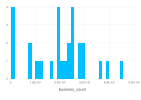

In [67]:
using Gadfly
plot(model_data, x=:business_count, Geom.histogram)

In [68]:
training_data = permutedims(Array(model_data), [2,1])

2×28 Matrix{Float64}:
 94110.0  94103.0  94109.0  94118.0  …  94158.0  94130.0  94129.0  94143.0
  4528.0   3862.0   3575.0   2974.0       145.0    142.0    141.0     14.0

In [69]:
result = kmeans(training_data, 3, init=:kmpp, display=:iter)

  Iters               objv        objv-change | affected 
-------------------------------------------------------------
      0       5.584457e+06
      1       4.879970e+06      -7.044872e+05 |        2
      2       4.730363e+06      -1.496070e+05 |        0
      3       4.730363e+06       0.000000e+00 |        0
K-means converged with 3 iterations (objv = 4.73036279655838e6)


KmeansResult{Matrix{Float64}, Float64, Int64}([94135.5 94107.33333333333 94114.82352941176; 552.875 3988.3333333333335 2354.5882352941176], [2, 2, 2, 3, 3, 3, 3, 3, 3, 3  …  3, 3, 1, 1, 1, 1, 1, 1, 1, 1], [291247.2222213745, 15978.888889312744, 170847.2222251892, 383681.02422332764, 366584.6124572754, 225118.02421951294, 170247.90657424927, 41788.90657424927, 34750.02421951294, 26384.14186859131  …  181209.55363082886, 523581.3183403015, 541900.265625, 259280.515625, 87101.015625, 52510.515625, 166868.265625, 168848.515625, 169683.265625, 290442.515625], [8, 3, 17], [8, 3, 17], 4.73036279655838e6, 3, true)

In [70]:
result.assignments

28-element Vector{Int64}:
 2
 2
 2
 3
 3
 3
 3
 3
 3
 3
 ⋮
 3
 1
 1
 1
 1
 1
 1
 1
 1

In [71]:
model_data[!,:cluster_id] = result.assignments

28-element Vector{Int64}:
 2
 2
 2
 3
 3
 3
 3
 3
 3
 3
 ⋮
 3
 1
 1
 1
 1
 1
 1
 1
 1

The algorithm has decided that businesses with the highest density belong in cluster 3, low density businesses in cluser in 2, and median cluster businesses in cluster 1

Best areas to target are zip codes 94110, 94103,94109, which have a combined density of 11,965 businesses

In [72]:
model_data

,zipcode,business_count,cluster_id
,Float64,Float64,Int64
1,94110.0,4528.0,2
2,94103.0,3862.0,2
3,94109.0,3575.0,2
4,94118.0,2974.0,3
5,94107.0,2960.0,3
6,94122.0,2829.0,3
7,94102.0,2767.0,3
8,94117.0,2559.0,3
9,94114.0,2541.0,3


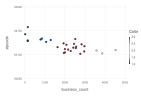

In [73]:
plot(model_data, y=:zipcode,x=:business_count,color=result.assignments,Geom.point,Scale.x_continuous(minvalue=0,maxvalue=5000), Scale.y_continuous(minvalue=94050,maxvalue=94200),Scale.x_continuous(format=:plain))

In [74]:
companies_in_top_areas = @from c in clean_df_geo begin
    @where in(c.Source_Zipcode, [94110,94103,94109])
    @select c
    @collect DataFrame
end

,DBA_Name,Source_Zipcode,NAICS_Code,NAICS_Code_Description
,String,Int64?,String?,String?
1,Zaalouk Market & Deli Grocery,94109,4400-4599,Retail Trade
2,1-11 Lilac St Apts,94110,5300-5399,Real Estate and Rental and Leasing Services
3,Sunflower Restaurant,94103,7220-7229,Food Services
4,Bay Music & Entertainment Inc,94109,7100-7199,"Arts, Entertainment, and Recreation"
5,Impark 0376,94109,4400-4599,Retail Trade
6,Geologica Inc,94103,5400-5499,"Professional, Scientific, and Technical Services"
7,Impark 0315,94109,4400-4599,Retail Trade
8,Impark 0324,94103,4400-4599,Retail Trade
9,Impark 0370,94103,4400-4599,Retail Trade


In [75]:
plot(companies_in_top_areas, y=:long, x=:lat, Geom.point, Scale.x_continuous(minvalue=36,maxvalue=40), Scale.y_continuous(minvalue=-125, maxvalue=-120),color=:Source_Zipcode)

In [76]:
companies_in_top_areas=@from c in companies_in_top_areas begin
    @where c.lat != minimum(companies_in_top_areas[!,:lat])
    @select c
    @collect DataFrame
end

,DBA_Name,Source_Zipcode,NAICS_Code,NAICS_Code_Description
,String,Int64?,String?,String?
1,Zaalouk Market & Deli Grocery,94109,4400-4599,Retail Trade
2,1-11 Lilac St Apts,94110,5300-5399,Real Estate and Rental and Leasing Services
3,Sunflower Restaurant,94103,7220-7229,Food Services
4,Bay Music & Entertainment Inc,94109,7100-7199,"Arts, Entertainment, and Recreation"
5,Impark 0376,94109,4400-4599,Retail Trade
6,Geologica Inc,94103,5400-5499,"Professional, Scientific, and Technical Services"
7,Impark 0315,94109,4400-4599,Retail Trade
8,Impark 0324,94103,4400-4599,Retail Trade
9,Impark 0370,94103,4400-4599,Retail Trade


In [77]:
activities = @from c in companies_in_top_areas begin
    @group c by c.NAICS_Code_Description into g
    @orderby descending(length(g))
    @select { activity = key(g), number_of_companies =length(g)}
    @collect DataFrame
end

,activity,number_of_companies
,String?,Int64
1,Real Estate and Rental and Leasing Services,3198
2,"Professional, Scientific, and Technical Services",1596
3,Retail Trade,1467
4,Food Services,1154
5,"Arts, Entertainment, and Recreation",894
6,Private Education and Health Services,568
7,Accommodations,537
8,Construction,496
9,Multiple,343


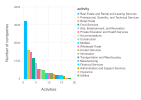

In [78]:
plot(activities, y=:number_of_companies, Geom.bar, color=:activity, Scale.y_continuous(format=:plain), Guide.XLabel("Activities"), Guide.YLabel("Number of companies"))

In [79]:
model_data= @from c in companies_in_top_areas begin
    @select { latitude=c.lat,longitude=c.long}
    @collect DataFrame
end

,latitude,longitude
,Float64,Float64
1,37.7877,-122.42
2,37.7519,-122.418
3,37.7649,-122.422
4,37.7957,-122.423
5,37.7891,-122.417
6,37.7875,-122.403
7,37.7894,-122.422
8,37.7867,-122.405
9,37.7818,-122.405


In [80]:
training_data = permutedims(Array(model_data),[2,1])

2×11964 Matrix{Float64}:
   37.7877    37.7519    37.7649  …    37.7845    37.7865    37.7535
 -122.42    -122.418   -122.422      -122.418   -122.423   -122.424

In [81]:
result=kmeans(training_data, 12, init=:kmpp,display=:iter)

  Iters               objv        objv-change | affected 
-------------------------------------------------------------
      0       5.809317e-01
      1       3.640467e-01      -2.168850e-01 |       11
      2       3.314458e-01      -3.260083e-02 |       11
      3       3.095801e-01      -2.186571e-02 |       11
      4       2.975670e-01      -1.201316e-02 |       11
      5       2.915249e-01      -6.042033e-03 |       11
      6       2.895153e-01      -2.009591e-03 |       11
      7       2.888244e-01      -6.909796e-04 |       10
      8       2.885553e-01      -2.690576e-04 |       10
      9       2.884303e-01      -1.250285e-04 |       10
     10       2.883654e-01      -6.489405e-05 |        8
     11       2.883230e-01      -4.235120e-05 |        8
     12       2.882986e-01      -2.446106e-05 |        9


     13       2.882860e-01      -1.258454e-05 |        6
     14       2.882810e-01      -4.984518e-06 |        3
     15       2.882764e-01      -4.572299e-06 |        3
     16       2.882733e-01      -3.111461e-06 |        3
     17       2.882732e-01      -1.614753e-07 |        2
K-means converged with 17 iterations (objv = 0.28827315487433225)


KmeansResult{Matrix{Float64}, Float64, Int64}([37.76156028909946 37.788238348794806 … 37.74066295953141 37.75068109759359; -122.41205055213258 -122.41956542155538 … -122.41870214483491 -122.41063600668458], [2, 4, 3, 7, 2, 6, 2, 6, 6, 6  …  7, 12, 3, 2, 4, 12, 4, 2, 2, 4], [7.18369847163558e-7, 1.4624238247051835e-5, 5.058245733380318e-7, 9.517825674265623e-6, 5.508794856723398e-6, 2.2996791813056916e-5, 7.66054290579632e-6, 1.2359792890492827e-5, 5.146946932654828e-6, 2.1998173906467855e-5  …  4.1995524952653795e-5, 1.2240925570949912e-5, 1.9751983927562833e-5, 1.0396157449577004e-5, 3.8584505091421306e-5, 2.9007424018345773e-6, 2.4472392397001386e-5, 1.7458864022046328e-5, 1.179025275632739e-5, 1.188114401884377e-5], [843, 2199, 1381, 1397, 7, 1062, 1364, 32, 809, 1183, 939, 748], [844, 2199, 1381, 1396, 7, 1062, 1364, 32, 809, 1183, 939, 748], 0.28827315487433225, 17, true)

In [82]:
result.counts

12-element Vector{Int64}:
  843
 2199
 1381
 1397
    7
 1062
 1364
   32
  809
 1183
  939
  748

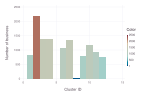

In [83]:
plot(result.counts, Geom.bar, y=result.counts, Guide.YLabel("Number of business"), Guide.XLabel("Cluster ID"), color=result.counts)

In [84]:
companies_in_top_areas[!,:cluster_id] = result.assignments

11964-element Vector{Int64}:
  2
  4
  3
  7
  2
  6
  2
  6
  6
  6
  ⋮
 12
  3
  2
  4
 12
  4
  2
  2
  4

Visualizing clusters

In [85]:
plot(companies_in_top_areas,color=:cluster_id,x=:lat,y=:long)

In [86]:
export_data = @from c in companies_in_top_areas begin
    @select { Name = c.DBA_Name,
    Zip = c.Source_Zipcode,
    Group=string("Cluster $(c.cluster_id)"),
    Latitude=c.lat,Longitude=c.long,
    City="San Francisco", State = "CA"}
    @collect DataFrame
end

,Name,Zip,Group,Latitude,Longitude,City
,String,Int64?,String,Float64,Float64,String
1,Zaalouk Market & Deli Grocery,94109,Cluster 2,37.7877,-122.42,San Francisco
2,1-11 Lilac St Apts,94110,Cluster 4,37.7519,-122.418,San Francisco
3,Sunflower Restaurant,94103,Cluster 3,37.7649,-122.422,San Francisco
4,Bay Music & Entertainment Inc,94109,Cluster 7,37.7957,-122.423,San Francisco
5,Impark 0376,94109,Cluster 2,37.7891,-122.417,San Francisco
6,Geologica Inc,94103,Cluster 6,37.7875,-122.403,San Francisco
7,Impark 0315,94109,Cluster 2,37.7894,-122.422,San Francisco
8,Impark 0324,94103,Cluster 6,37.7867,-122.405,San Francisco
9,Impark 0370,94103,Cluster 6,37.7818,-122.405,San Francisco


In [91]:
CSV.write("businesses.csv", first(export_data, 250))

"businesses.csv"